In [288]:
# Required Modules
import pandas as pd
import numpy as np
import lazypredict
import warnings
warnings.filterwarnings("ignore")

from scipy import stats

from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error


from lazypredict.Supervised import LazyRegressor
from lazypredict.Supervised import LazyClassifier

from lightgbm import LGBMRegressor
from lightgbm import LGBMClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LogisticRegression

In [2]:
data = pd.read_csv('Resources/Final_Data.csv')
data.head()

,Zip_Code,Date,Year,Month,Sale_Price,Interest_Rate,Property_Tax,Rent_Price,Household_Income,Rent_Affordability,...,FTE_Employed,Unemployed,Expense_Index,Average_Commute,Crime_Index,Loan_Amount,Loan_Term,Loan_R,Loan_Payment,Home_Affordability
0,32003,2019-01-01,2019,1,244950.00,4.46,3778,1113,94154.00,0.14,...,10671,1069,104,35,28,195960.00,360.00,1.00,988.71,0.13
1,32003,2019-02-01,2019,2,270000.00,4.37,3778,1113,94154.00,0.14,...,10671,1069,104,35,28,216000.00,360.00,1.00,1077.82,0.14
2,32003,2019-03-01,2019,3,275000.00,4.26,3778,1113,94154.00,0.14,...,10671,1069,104,35,28,220000.00,360.00,1.00,1084.20,0.14
3,32003,2019-04-01,2019,4,264500.00,4.14,3778,1113,94154.00,0.14,...,10671,1069,104,35,28,211600.00,360.00,1.00,1027.67,0.13
4,32003,2019-05-01,2019,5,281000.00,4.07,3778,1113,94154.00,0.14,...,10671,1069,104,35,28,224800.00,360.00,1.00,1082.58,0.14


In [86]:
ml_data = data[['Zip_Code', 'Year', 'Month', 'Mobility_Rate', 'Expense_Index', 'Crime_Index' , 'Total_Vacant', 'Total_Dwellings', 'Total_Sales', 'FHA_Count', 'Home_Affordability', 'Rent_Affordability', 'Sale_Price' ]]
ml_data.index = ml_data['Zip_Code']
ml_data

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price
Zip_Code,,,,,,,,,,,,,
32003,32003,2019,1,0.18,104,28,704,11724,32,7,0.13,0.14,244950.00
32003,32003,2019,2,0.18,104,28,704,11724,41,2,0.14,0.14,270000.00
32003,32003,2019,3,0.18,104,28,704,11724,21,7,0.14,0.14,275000.00
32003,32003,2019,4,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00
32003,32003,2019,5,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...
34997,34997,2021,1,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00
34997,34997,2021,2,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00
34997,34997,2021,2,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00


In [85]:
ml_data.dtypes

Zip_Code                int64
Year                    int64
Month                   int64
Mobility_Rate         float64
Expense_Index           int64
Crime_Index             int64
Total_Vacant            int64
Total_Dwellings         int64
Total_Sales             int64
FHA_Count               int64
Home_Affordability    float64
Rent_Affordability    float64
Sale_Price            float64
dtype: object

In [13]:
count = np.isinf(ml_data).values.sum()
print("It contains " + str(count) + " infinite values")

It contains 0 infinite values


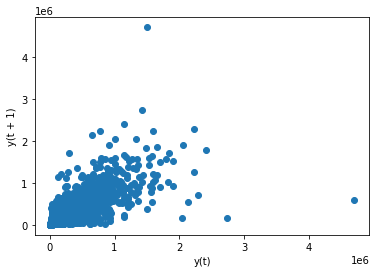

In [78]:
from pandas.plotting import lag_plot
lag_plot(ml_data)

In [341]:
ml_data_3mo = ml_data.sort_values(by = ['Zip_Code', 'Year', 'Month'], ascending = [True, True, True])
ml_data_3mo.head()

ValueError: 'Zip_Code' is both an index level and a column label, which is ambiguous.

In [342]:
ml_data_3mo['Last_Month_Price'] = ml_data_3mo.groupby(['Zip_Code'])['Sale_Price'].shift()
ml_data_3mo['Last_2Month_Price'] = ml_data_3mo.groupby(['Zip_Code'])['Sale_Price'].shift(2)
ml_data_3mo['Future_Month_Price'] = ml_data_3mo.groupby(['Zip_Code'])['Sale_Price'].shift(-1)
ml_data_3mo['Future_2Month_Price'] = ml_data_3mo.groupby(['Zip_Code'])['Sale_Price'].shift(-2)
ml_data_3mo['Future_3Month_Price'] = ml_data_3mo.groupby(['Zip_Code'])['Sale_Price'].shift(-3)


# price_difference_1 = []
# price_difference_2 = []
# price_difference_3 = []


# for column in ml_data_3mo[['Sale_Price', 'Last_Month_Price', 'Future_Month_Price',
#                     'Future_2Month_Price', 'Future_3Month_Price']]:
#    # Select column contents by column name using [] operator
#     current_sales = ml_data_3mo['Sale_Price'].values
#     last_sales = ml_data_3mo['Future_Month_Price'].values
#     last_2mo_sale = ml_data_3mo['Future_2Month_Price'].values
#     last_3mo_sale = ml_data_3mo['Future_3Month_Price'].values
#     price_difference_1.append(current_sales-last_sales)
#     price_difference_2.append(current_sales-last_2mo_sale)
#     price_difference_3.append(current_sales-last_3mo_sale)
    

# ml_data_3mo['Last_Month_Diff'] = price_difference_1[0]
# ml_data_3mo['Last_2Month_Diff'] = price_difference_2[0]
# ml_data_3mo['Last_3Month_Diff'] = price_difference_3[0]

ml_data_3mo

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Future_Month_Price,Future_2Month_Price,Future_3Month_Price
0,32003,2019,1,0.18,104,28,704,11724,32,7,0.13,0.14,244950.00,nan,nan,270000.00,275000.00,264500.00
1,32003,2019,2,0.18,104,28,704,11724,41,2,0.14,0.14,270000.00,244950.00,nan,275000.00,264500.00,281000.00
2,32003,2019,3,0.18,104,28,704,11724,21,7,0.14,0.14,275000.00,270000.00,244950.00,264500.00,281000.00,275000.00
3,32003,2019,4,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00,275000.00,270000.00,281000.00,275000.00,282500.00
4,32003,2019,5,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00,264500.00,275000.00,275000.00,282500.00,269577.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24466,34997,2021,1,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00,305000.00,297000.00,300000.00,300000.00,599000.00
24467,34997,2021,2,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00,305000.00,305000.00,300000.00,599000.00,599000.00
24468,34997,2021,2,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00,300000.00,305000.00,599000.00,599000.00,nan
24469,34997,2021,3,0.14,91,113,2976,21551,7,12,0.42,0.25,599000.00,300000.00,300000.00,599000.00,nan,nan


In [343]:
ml_data_3mo.replace([np.inf, -np.inf], np.nan, inplace=True)
ml_data_3mo.dropna(inplace=True)

In [10]:
price_change_3mo = []

for row in ml_data_3mo['Future_3Month_Diff']:
    if row > 0:
        price_change_3mo.append(1)
    else:
        price_change_3mo.append(0)
ml_data_3mo['Price_Change_3mo'] = price_change_3mo

ml_data_3mo

KeyError: 'Future_3Month_Diff'

In [344]:
predict_21 = ml_data_3mo[ml_data_3mo['Year'] == 2021]

predict_21

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Future_Month_Price,Future_2Month_Price,Future_3Month_Price
24,32003,2021,1,0.18,104,28,704,11724,39,6,0.12,0.14,299900.00,294000.00,336000.00,333800.00,339950.00,470000.00
290,32043,2021,1,0.16,93,103,1013,11869,43,16,0.13,0.20,230000.00,209950.00,262500.00,249000.00,240500.00,249495.00
587,32065,2021,1,0.18,106,62,1178,15457,58,22,0.14,0.19,250000.00,258000.00,222300.00,238600.00,221850.00,269000.00
637,32068,2021,1,0.15,100,90,1618,21871,45,35,0.13,0.21,205000.00,213225.00,195000.00,243000.00,257050.00,175000.00
691,32073,2021,1,0.23,91,94,1312,17051,59,18,0.14,0.22,213000.00,206000.00,223550.00,215000.00,217750.00,190000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24412,34996,2021,1,0.14,78,140,2780,9249,51,0,0.19,0.21,345000.00,345000.00,390000.00,395000.00,395000.00,465950.00
24413,34996,2021,2,0.14,78,140,2780,9249,57,1,0.23,0.21,395000.00,345000.00,345000.00,395000.00,465950.00,465950.00
24465,34997,2021,1,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00,297000.00,297000.00,305000.00,300000.00,300000.00
24466,34997,2021,1,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00,305000.00,297000.00,300000.00,300000.00,599000.00


In [345]:
predict_21 = predict_21.drop(columns=['Zip_Code', 'Year', 'Month', 'Future_Month_Price', 'Future_2Month_Price' ])
predict_21

,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Future_3Month_Price
24,0.18,104,28,704,11724,39,6,0.12,0.14,299900.00,294000.00,336000.00,470000.00
290,0.16,93,103,1013,11869,43,16,0.13,0.20,230000.00,209950.00,262500.00,249495.00
587,0.18,106,62,1178,15457,58,22,0.14,0.19,250000.00,258000.00,222300.00,269000.00
637,0.15,100,90,1618,21871,45,35,0.13,0.21,205000.00,213225.00,195000.00,175000.00
691,0.23,91,94,1312,17051,59,18,0.14,0.22,213000.00,206000.00,223550.00,190000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...
24412,0.14,78,140,2780,9249,51,0,0.19,0.21,345000.00,345000.00,390000.00,465950.00
24413,0.14,78,140,2780,9249,57,1,0.23,0.21,395000.00,345000.00,345000.00,465950.00
24465,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00,297000.00,297000.00,300000.00
24466,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00,305000.00,297000.00,599000.00


In [346]:
y_test = predict_21['Future_3Month_Price'].values

X_test = predict_21.drop(columns='Future_3Month_Price')

feature_test_names = X_test.columns

X_test

,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price
24,0.18,104,28,704,11724,39,6,0.12,0.14,299900.00,294000.00,336000.00
290,0.16,93,103,1013,11869,43,16,0.13,0.20,230000.00,209950.00,262500.00
587,0.18,106,62,1178,15457,58,22,0.14,0.19,250000.00,258000.00,222300.00
637,0.15,100,90,1618,21871,45,35,0.13,0.21,205000.00,213225.00,195000.00
691,0.23,91,94,1312,17051,59,18,0.14,0.22,213000.00,206000.00,223550.00
...,...,...,...,...,...,...,...,...,...,...,...,...
24412,0.14,78,140,2780,9249,51,0,0.19,0.21,345000.00,345000.00,390000.00
24413,0.14,78,140,2780,9249,57,1,0.23,0.21,395000.00,345000.00,345000.00
24465,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00,297000.00,297000.00
24466,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00,305000.00,297000.00


In [347]:
ml_data_3mo = ml_data_3mo[ml_data_3mo['Year'] < 2021]
ml_data_3mo.head()

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Future_Month_Price,Future_2Month_Price,Future_3Month_Price
2,32003,2019,3,0.18,104,28,704,11724,21,7,0.14,0.14,275000.00,270000.00,244950.00,264500.00,281000.00,275000.00
3,32003,2019,4,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00,275000.00,270000.00,281000.00,275000.00,282500.00
4,32003,2019,5,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00,264500.00,275000.00,275000.00,282500.00,269577.00
5,32003,2019,6,0.18,104,28,704,11724,43,3,0.13,0.14,275000.00,281000.00,264500.00,282500.00,269577.00,286000.00
6,32003,2019,7,0.18,104,28,704,11724,90,7,0.13,0.14,282500.00,275000.00,281000.00,269577.00,286000.00,258000.00


In [348]:
# ml_data_3mo = ml_data_3mo.drop(columns=['Zip_Code', 'Year', 'Month', 'Last_Month_Price',
#                         'Last_2Month_Price', 'Last_2Month_Price', 'Last_Month_Diff',
#                         'Last_2Month_Diff', 'Last_3Month_Price', 'Last_3Month_Diff'])
# ml_data_3mo

ml_data_3mo = ml_data_3mo.drop(columns=['Zip_Code', 'Year', 'Month', 'Future_Month_Price', 'Future_2Month_Price' ])
ml_data_3mo

,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Future_3Month_Price
2,0.18,104,28,704,11724,21,7,0.14,0.14,275000.00,270000.00,244950.00,275000.00
3,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00,275000.00,270000.00,282500.00
4,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00,264500.00,275000.00,269577.00
5,0.18,104,28,704,11724,43,3,0.13,0.14,275000.00,281000.00,264500.00,286000.00
6,0.18,104,28,704,11724,90,7,0.13,0.14,282500.00,275000.00,281000.00,258000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...
24460,0.14,91,113,2976,21551,139,17,0.19,0.25,285000.00,285000.00,256000.00,297000.00
24461,0.14,91,113,2976,21551,132,11,0.17,0.25,259750.00,285000.00,285000.00,297000.00
24462,0.14,91,113,2976,21551,132,11,0.17,0.25,259750.00,259750.00,285000.00,305000.00
24463,0.14,91,113,2976,21551,142,16,0.20,0.25,297000.00,259750.00,259750.00,305000.00


In [349]:
y_train= ml_data_3mo['Future_3Month_Price'].values

X_train = ml_data_3mo.drop(columns='Future_3Month_Price')

feature_train_names = X_train.columns

X_train

,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price
2,0.18,104,28,704,11724,21,7,0.14,0.14,275000.00,270000.00,244950.00
3,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00,275000.00,270000.00
4,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00,264500.00,275000.00
5,0.18,104,28,704,11724,43,3,0.13,0.14,275000.00,281000.00,264500.00
6,0.18,104,28,704,11724,90,7,0.13,0.14,282500.00,275000.00,281000.00
...,...,...,...,...,...,...,...,...,...,...,...,...
24460,0.14,91,113,2976,21551,139,17,0.19,0.25,285000.00,285000.00,256000.00
24461,0.14,91,113,2976,21551,132,11,0.17,0.25,259750.00,285000.00,285000.00
24462,0.14,91,113,2976,21551,132,11,0.17,0.25,259750.00,259750.00,285000.00
24463,0.14,91,113,2976,21551,142,16,0.20,0.25,297000.00,259750.00,259750.00


In [22]:
reg = LazyRegressor(verbose=0, ignore_warnings=False, custom_metric=None)
reg_models, reg_predictions = reg.fit(X_train, X_test, y_train, y_test)
print(reg_models)

100%|██████████| 42/42 [02:42<00:00,  3.87s/it]                               Adjusted R-Squared  R-Squared      RMSE  \
Model                                                                    
ExtraTreeRegressor                           0.99       0.99  12581.20   
DecisionTreeRegressor                        0.99       0.99  12762.37   
ExtraTreesRegressor                          0.99       0.99  12863.38   
RandomForestRegressor                        0.97       0.97  26873.27   
BaggingRegressor                             0.96       0.96  30151.92   
XGBRegressor                                 0.94       0.94  34505.20   
LGBMRegressor                                0.89       0.89  49356.45   
KNeighborsRegressor                          0.87       0.87  53440.78   
HistGradientBoostingRegressor                0.87       0.87  53889.35   
GradientBoostingRegressor                    0.86       0.86  54688.04   
TransformedTargetRegressor                   0.80       0.81  648

In [350]:
#Random Forest Regressor
rf_regr = RandomForestRegressor(n_estimators=1000, n_jobs=-1, random_state=42)
rf_regr.fit(X_train, y_train)

RandomForestRegressor(n_estimators=1000, n_jobs=-1, random_state=42)

In [351]:
print(f"Training Data Score: {rf_regr.score(X_train, y_train)}")
print(f"Testing Data Score: {rf_regr.score(X_test, y_test)}")

Training Data Score: 0.9749940519289849
Testing Data Score: 0.48487267626650377


In [352]:
def rmsle(ytrue, ypred):
    return np.sqrt(mean_squared_log_error(ytrue, ypred))

In [353]:
rf_pred = rf_regr.predict(X_test)

error = rmsle(y_test, rf_pred)
    
print('Mean Error = %.5f' % np.mean(error))

Mean Error = 0.45725


In [ ]:
from sklearn.model_selection import GridSearchCV
param_grid = {'C': [1, 5, 10],
              'gamma': [0.0001, 0.001, 0.01]}
grid = GridSearchCV(model, param_grid, verbose=3)
grid

In [335]:
zip_test = ml_data.loc[32608].drop(columns=['Zip_Code', 'Year', 'Mobility_Rate', 'Expense_Index', 
                    'Crime_Index', 'Total_Vacant', 'Total_Dwellings', 'Rent_Affordability', 
                    'Home_Affordability'])
zip_test

,Month,Total_Sales,FHA_Count,Sale_Price
Zip_Code,,,,
32608,1,50,2,153550.00
32608,2,49,4,192500.00
32608,3,42,5,163500.00
32608,4,95,1,184300.00
32608,5,102,5,174950.00
32608,6,91,6,171000.00
32608,7,105,4,163800.00
32608,8,78,2,168250.00
32608,9,45,4,137000.00


In [354]:
# from statsmodels.tsa.ar_model import AutoReg
from statsmodels.tsa.vector_ar.var_model import VAR

X = zip_test.values

train= X[:24]
test = X[24:]


In [355]:
ar_model = VAR(endog=train)
ar_model_fit = ar_model.fit()

In [356]:
prediction = ar_model_fit.forecast(ar_model_fit.y, steps=len(test))

In [357]:
from math import sqrt
columns = ['Month', 'Total_Sales', 'FHA_Count', 'Sale_Price']
pred = pd.DataFrame(index=range(0,len(prediction)),columns=columns)
for j in range(0,4):
    for i in range(0, len(prediction)):
       pred.iloc[i][j] = prediction[i][j]

# for i in columns:
#     print('rmse value for', i, 'is : ', sqrt(mean_squared_error(pred[i], test[i])))

# check rmse
pred = pred.drop(columns='Month')

In [358]:
pred[['Total_Sales', 'FHA_Count', 'Sale_Price']] = pred[['Total_Sales', 'FHA_Count', 
                                            'Sale_Price']].astype(int)

# rmse_ts = []
# rmse_fha = []
# rmse_sp = []

# for column in pred[['Total_Sales', 'FHA_Count', 'Sale_Price']]:
#     ts = pred['Total_Sales'].values
#     fha = pred['FHA_Count'].values
#     sp = pred['Sale_Price'].values
#     rmse_ts.append(sqrt(mean_squared_error(pred[ts], test[int(ts)])))
#     rmse_fha.append(sqrt(mean_squared_error(pred[fha], test[int(fha)])))
#     # rmse_sp.append(sp)
#     # print('rmse value for', column, 'is : ', sqrt(mean_squared_error(pred[column], prediction[column])))

# # pred

# rmse_ts
pred

,Total_Sales,FHA_Count,Sale_Price
0,71,4,217652
1,65,4,214652
2,63,4,213624


In [359]:
import statsmodels.api as sm
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.graphics.api import qqplot

In [305]:
arma_model = ARIMA(endog=zip_test['Total_Sales']).fit()

In [307]:
resid = arma_model.resid
stats.normaltest(resid)

# fig = plt.figure(figsize=(12,8))
# ax = fig.add_subplot(111)
# fig = qqplot(resid, line='q', ax=ax, fit=True)

NormaltestResult(statistic=2.775330671374032, pvalue=0.2496574911972949)

In [309]:
arma_predict = arma_model.predict('10', '12', dynamic=True)


KeyError: 'The `start` argument could not be matched to a location related to the index of the data.'